<h2><center>Author: Ricardo Manzano Sanchez.</center></h2>
<h2><center>Email: ricardoamsrams@gmail.com</center></h2>

In the present report, it is analyzed two classification algorithms such as KNN(K nearest neighbors) and SVM(Support Vector Machine) Linear to predict if a person will suscribe a term deposit using 15 inputs of the Bank Marketing Data Set. The dataset used is bank-full.csv. This data set has the following attributes

__Bank client data:__
   1. age (numeric)
   2. job : type of job (categorical: "admin.","unknown","unemployed","management","housemaid","entrepreneur","student", "blue-collar","self-employed","retired","technician","services") #12
   3. marital : marital status (categorical: "married","divorced","single"; note: "divorced" means divorced or widowed) #3
   4. education (categorical: "unknown","secondary","primary","tertiary") #4
   5. default: has credit in default? (binary: "yes","no") 
   6. balance: average yearly balance, in euros (numeric) 
   7. housing: has housing loan? (binary: "yes","no")
   8. loan: has personal loan? (binary: "yes","no")
   
__Related with the last contact of the current campaign:__

   9. contact: contact communication type (categorical: "unknown","telephone","cellular") #3
   10. day: last contact day of the month (numeric) 
   11. month: last contact month of year (categorical: "jan", "feb", "mar", ..., "nov", "dec") #12
   12. duration: last contact duration, in seconds (numeric)
  
__Other attributes:__
 
   13. campaign: number of contacts performed during this campaign and for this client (numeric, includes last contact)
   14. pdays: number of days that passed by after the client was last contacted from a previous campaign (numeric, -1 means client was not previously contacted)
   15. previous: number of contacts performed before this campaign and for this client (numeric)
   16. poutcome: outcome of the previous marketing campaign (categorical: "unknown","other","failure","success") #4

__Output variable (desired target):__
  
   17. y - has the client subscribed a term deposit? (binary: "yes","no")
   
   
It is necessary to highlight that  the attribute 12 __Duration__ has been ommited from the analysis because it has major influence in the output variable according to the data set description.

KNN and SVM does not work with categorical data, and most of the attributes in the data set are categorical. For this reason, considering that each attribute does not have big cardinality, it has been used One_Hot encoding. 





In [1]:
import pandas as pd   #import pandas library with the name pd
import matplotlib.pyplot as plt #import matplotlib library with the name plt
import numpy as num     #import the library numpy with the name num
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt   # import matplotlib with the name plt 
import matplotlib                 #import matplotlib

__Item 1:__ The following lines of code are used to import the data as a dataframe

In [2]:
path = 'bank-full.csv'  #path to extract data
z=pd.read_csv(path,delimiter=";")  #varible where the data is stored
print(z)


       age            job   marital  education default  balance housing loan  \
0       58     management   married   tertiary      no     2143     yes   no   
1       44     technician    single  secondary      no       29     yes   no   
2       33   entrepreneur   married  secondary      no        2     yes  yes   
3       47    blue-collar   married    unknown      no     1506     yes   no   
4       33        unknown    single    unknown      no        1      no   no   
5       35     management   married   tertiary      no      231     yes   no   
6       28     management    single   tertiary      no      447     yes  yes   
7       42   entrepreneur  divorced   tertiary     yes        2     yes   no   
8       58        retired   married    primary      no      121     yes   no   
9       43     technician    single  secondary      no      593     yes   no   
10      41         admin.  divorced  secondary      no      270     yes   no   
11      29         admin.    single  sec

As we can see some attibutes are categorical. Hence, it is necessary to transform it to numerical data because SVM and KNN use numerical data to train and test the models.

The attributes default, housing, loan and the output have only two clases __YES__ or __NO__. For this reason, YES will be replaced by 1, and NO by 0.

In [3]:
z.iloc[:,4]=z.iloc[:,4].replace('yes', 1)  #Replace 1 instead of yes
z.iloc[:,4]=z.iloc[:,4].replace('no', 0)   #Replace 0 instead of no
z.iloc[:,6]=z.iloc[:,6].replace('yes', 1)  #Replace 1 instead of yes
z.iloc[:,6]=z.iloc[:,6].replace('no', 0)   #Replace 0 instead of no
z.iloc[:,7]=z.iloc[:,7].replace('yes', 1)  #Replace 1 instead of yes
z.iloc[:,7]=z.iloc[:,7].replace('no', 0)   #Replace 0 instead of no
z.iloc[:,16]=z.iloc[:,16].replace('yes', 1)  #Replace 1 instead of yes
z.iloc[:,16]=z.iloc[:,16].replace('no', 0)   #Replace 0 instead of no
print(z)
#z.to_csv('h310.csv', sep=',')

       age            job   marital  education  default  balance  housing  \
0       58     management   married   tertiary        0     2143        1   
1       44     technician    single  secondary        0       29        1   
2       33   entrepreneur   married  secondary        0        2        1   
3       47    blue-collar   married    unknown        0     1506        1   
4       33        unknown    single    unknown        0        1        0   
5       35     management   married   tertiary        0      231        1   
6       28     management    single   tertiary        0      447        1   
7       42   entrepreneur  divorced   tertiary        1        2        1   
8       58        retired   married    primary        0      121        1   
9       43     technician    single  secondary        0      593        1   
10      41         admin.  divorced  secondary        0      270        1   
11      29         admin.    single  secondary        0      390        1   

It was excluded the feature __duration__ because it has a big influence over the output.

In [4]:
a=z.iloc[:,num.r_[0:11,12:16]]  # Code to drop the attribute duration
#a.to_csv('h31.csv', sep=',')
b=z.iloc[:,16]             #assign in b the values of the labels
#print(b)

As we described earlier, some attributes are categorical. Thus, it has been used One_hot encoding to solve the problem

In [5]:
d=pd.DataFrame(a).copy()      #copy the dataframe a into d
r=pd.get_dummies(data=d,columns=['job', 'marital','education','contact','month','poutcome']) #Aply one_hot encoding to some attributes
print(r)
#r.to_csv('h312.csv', sep=',')

       age  default  balance  housing  loan  day  campaign  pdays  previous  \
0       58        0     2143        1     0    5         1     -1         0   
1       44        0       29        1     0    5         1     -1         0   
2       33        0        2        1     1    5         1     -1         0   
3       47        0     1506        1     0    5         1     -1         0   
4       33        0        1        0     0    5         1     -1         0   
5       35        0      231        1     0    5         1     -1         0   
6       28        0      447        1     1    5         1     -1         0   
7       42        1        2        1     0    5         1     -1         0   
8       58        0      121        1     0    5         1     -1         0   
9       43        0      593        1     0    5         1     -1         0   
10      41        0      270        1     0    5         1     -1         0   
11      29        0      390        1     0    5    

The dataset has 47 attributes which will be used to train and test KNN and SVM linear classifiers.

__Item 2 and 3__ 

Due to the fact that the attributes with continuos values have different scales, it has been used min max normalization to have the same scale for each attribute.


In [6]:
scaler_minmax = MinMaxScaler(feature_range=(0, 1))  # scale attributes with continuos values between 0 and 1
scaler_minmax  = scaler_minmax.fit(r)    #fit min max normalization
normalized_minmax = scaler_minmax.transform(r) #normalized data with min max
#num.savetxt("hw34.csv",normalized_minmax, delimiter=",")



c:\users\ramanzan\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\data.py:323: DataConversionWarning: Data with input dtype uint8, int64 were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)


It has been used the libraries of Sklearn to train and test the KNN and SVM classifier.
It has been trained the model using the 70% of the data, and it has been used 30% of the data to test 

__SVM LINEAR__

In [7]:
from sklearn.model_selection import train_test_split   #library tp split the data in training and testing
X_train, X_test, y_train, y_test = train_test_split(normalized_minmax, b, test_size = 0.30)   #function to split the data in training and testing
from sklearn.svm import SVC  # library to use SVM 
svclassifier = SVC(kernel='linear')   #it will be used linear SVM
svclassifier.fit(X_train, y_train)    #it is trained SVM linear with training data
y_pred = svclassifier.predict(X_test)  #it is predicted the labels using testing data
from sklearn.metrics import classification_report, confusion_matrix  #library to use confusion matrix and classification_report
#print(confusion_matrix(y_test,y_pred))   #it is printed the confusion matrix
print(classification_report(y_test,y_pred)) #it is printed the results of the SVM linear



              precision    recall  f1-score   support

           0       0.90      0.99      0.94     11973
           1       0.67      0.19      0.30      1591

   micro avg       0.89      0.89      0.89     13564
   macro avg       0.79      0.59      0.62     13564
weighted avg       0.87      0.89      0.87     13564



In the next section, it is plotted all the possible pairs of attributes with the predicted labels

In [9]:
columnsNamesArr = r.columns.values

c:\users\ramanzan\appdata\local\programs\python\python36\lib\site-packages\matplotlib\pyplot.py:513: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


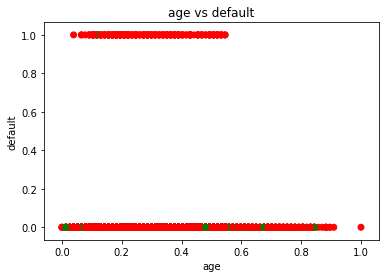

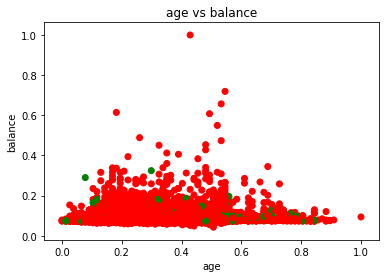

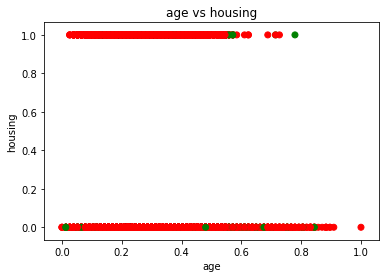

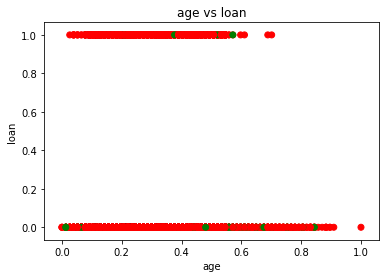

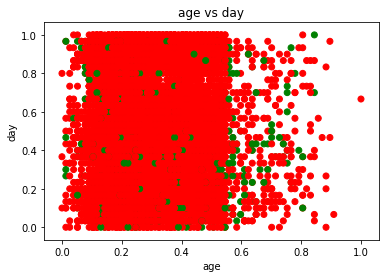

...

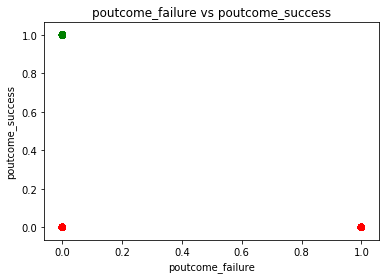

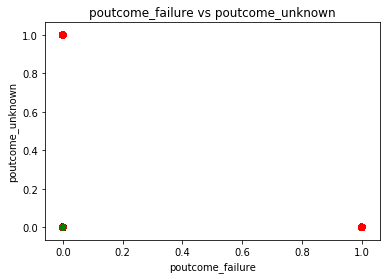

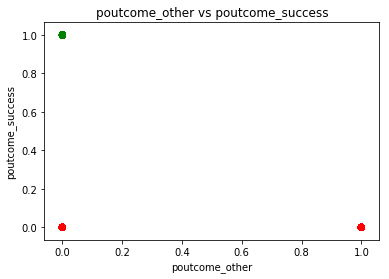

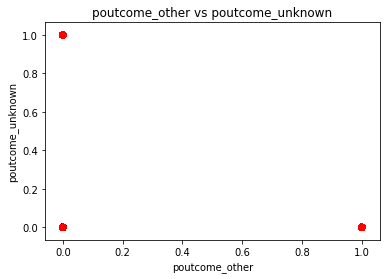

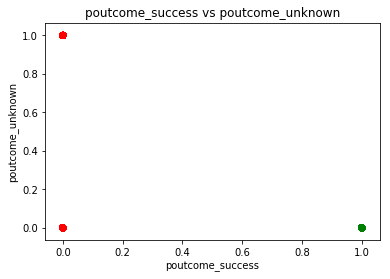

In [10]:
colors = ['red','green']   #colors to plot the labels 
aux=1    
number_attributes=r.shape[1]  # it is extracted the number of attributes 
#number_attributes=4
for i in range(0,number_attributes):
    for j in range(i+1,number_attributes):
        aux=aux+1
        plt.figure(aux)                          #Create new plot
        plt.title('%s vs %s'%(columnsNamesArr[i],columnsNamesArr[j])) # plot the title
        plt.scatter(X_test[:,i],X_test[:,j],c=y_pred,cmap=matplotlib.colors.ListedColormap(colors))#plot the attributes with labels
        plt.xlabel(columnsNamesArr[i]) #plot label in x
        plt.ylabel(columnsNamesArr[j])  #plot label in y
        #plt.xlabel('Attribute %i'%i)
        #plt.ylabel('Attribute %i'%j)


__KNN__

K nearest neighbors has been used to train the model. In this case 3 neighbors have been considered to take the final decission.


In [11]:
from sklearn.neighbors import KNeighborsClassifier #library to use k nearest neighbor
neigh = KNeighborsClassifier(n_neighbors=3)   #it is defined the numbers of neighbors
neigh.fit(X_train, y_train)   #it is fitted the model KNN
y_pred1 = neigh.predict(X_test)  #it is predicted the labels using testing data
from sklearn.metrics import classification_report, confusion_matrix  #library to use confusion matrix and classification_report
#print(confusion_matrix(y_test,y_pred1))  
print(classification_report(y_test,y_pred1))  #it is printed the results of the SVM linear

              precision    recall  f1-score   support

           0       0.91      0.96      0.93     11973
           1       0.46      0.25      0.33      1591

   micro avg       0.88      0.88      0.88     13564
   macro avg       0.68      0.61      0.63     13564
weighted avg       0.85      0.88      0.86     13564



In the next section, it is plotted all the possible pairs of attributes with the predicted labels

c:\users\ramanzan\appdata\local\programs\python\python36\lib\site-packages\matplotlib\pyplot.py:513: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


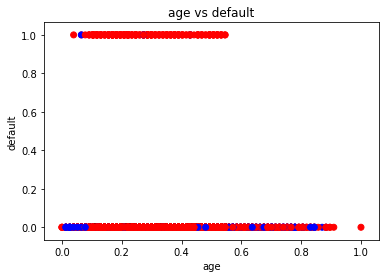

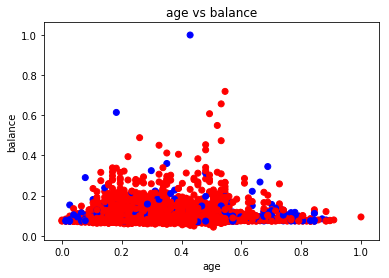

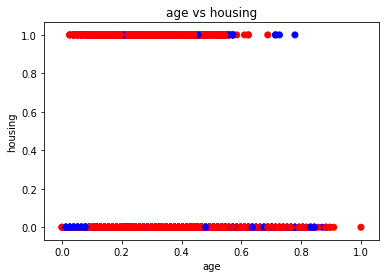

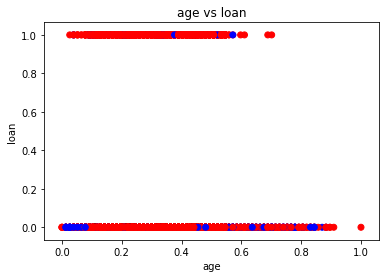

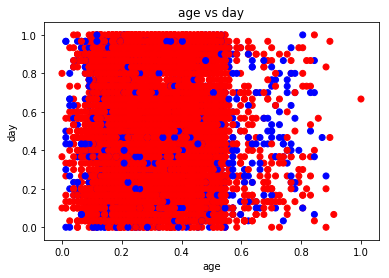

...

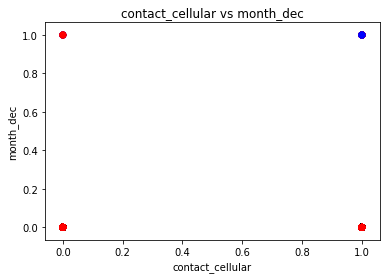

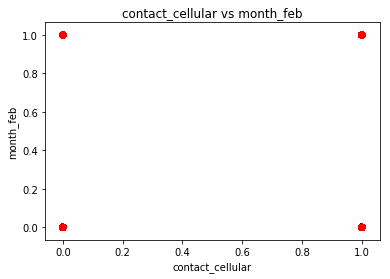

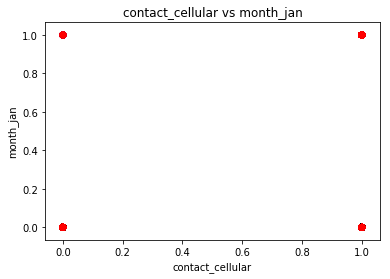

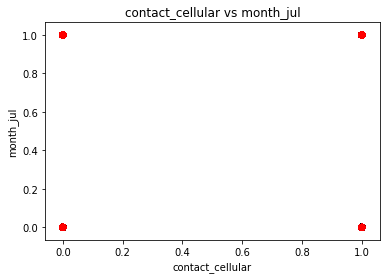

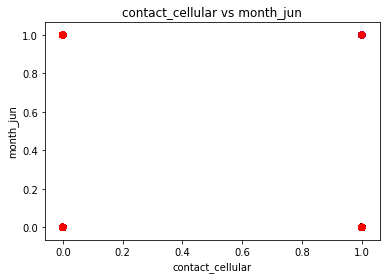

In [12]:
colors = ['red','blue']   #colors to plot the labels 
aux=1    
number_attributes=r.shape[1]  # it is extracted the number of attributes 
#number_attributes=4
for i in range(0,number_attributes):
    for j in range(i+1,number_attributes):
        aux=aux+1
        plt.figure(aux)                          #Create new plot
        plt.title('%s vs %s'%(columnsNamesArr[i],columnsNamesArr[j])) # plot the title
        plt.scatter(X_test[:,i],X_test[:,j],c=y_pred1,cmap=matplotlib.colors.ListedColormap(colors))#plot the attributes with labels
        plt.xlabel(columnsNamesArr[i]) #plot label in x
        plt.ylabel(columnsNamesArr[j])  #plot label in y
        #plt.xlabel('Attribute %i'%i)
        #plt.ylabel('Attribute %i'%j)

__Item 4 RESULTS__

After analyzing the graphs shown above, we can conclude that poutcome_succes is an attribute which can discriminate both classes very well specially when SVM linear is used. As we can see, when the feature poutcome_success is plotted against any other attribute, the classes can be identify easily. However, when we use K nearest neighbor, we can see that it is necessary more than 2 attributes to discriminate both classes. In terms of f1-measure accuracy, we can conclude that models can not generalize well when a client will not suscribe a term deposit. It is possible that svm linear and KNN using 3 neighbors can not classify well new datapoints.